# Reclassifying the news

In [1]:
from __future__ import unicode_literals
import time
from itertools import chain
import tqdm
from tqdm import tqdm_notebook
import spacy
import json
from spacy.tokens import Doc, Token, Span
from spacy.matcher import PhraseMatcher
from spacy.matcher import Matcher

from spacy.language import Language

from spacy import displacy 

from spacy.lang.en.stop_words import STOP_WORDS

from spacy.lemmatizer import Lemmatizer
from spacy.lang.en import LEMMA_INDEX, LEMMA_EXC, LEMMA_RULES

import textacy

import nltk
from nltk.corpus import stopwords
from nltk import FreqDist, word_tokenize
import string, re, regex

import pandas as pd
import numpy as np

import pymysql.cursors
#from credentials import username, password, host, dbname

import pickle

In [2]:
from sklearn.base import TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.svm import LinearSVC

from gensim.test.utils import common_corpus, common_dictionary
from gensim.sklearn_api import LdaTransformer
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.model_selection import GridSearchCV

from sklearn.feature_extraction.stop_words import ENGLISH_STOP_WORDS
from sklearn.metrics import accuracy_score

In [3]:
import gensim
import gensim.corpora as corpora
from gensim import models
from gensim.models import TfidfModel
import numpy as np

from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from pprint import pprint

In [4]:
import matplotlib as plt
import matplotlib.pyplot as plt
import seaborn as sns 

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import Pipeline

import pyLDAvis.sklearn

import pyLDAvis
import pyLDAvis.gensim  # don't skip this
%matplotlib notebook

In [3]:
nytimes = pd.read_csv('csv/nytimes.csv')
nytimes.columns

Index(['Unnamed: 0', 'id', 'title', 'author', 'content', 'date', 'year',
       'month', 'front_page', 'url', 'date_counter', 'stems'],
      dtype='object')

In [389]:
nytimes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10732 entries, 0 to 10731
Data columns (total 12 columns):
Unnamed: 0      10732 non-null int64
id              10732 non-null int64
title           10732 non-null object
author          10732 non-null object
content         10732 non-null object
date            10732 non-null object
year            10732 non-null float64
month           10732 non-null float64
front_page      10732 non-null bool
url             10732 non-null object
date_counter    10732 non-null object
stems           10732 non-null object
dtypes: bool(1), float64(2), int64(2), object(7)
memory usage: 932.8+ KB


In [390]:
nytimes.head()

,Unnamed: 0,id,title,author,content,date,year,month,front_page,url,date_counter,stems
0,1,2,"How the Russia Inquiry Began: A Campaign Aide,...",Sharon LaFraniere,WASHINGTON — During a night of heavy drinking ...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/us/politics...,0_2018,washington -- during a night of heavy drinking...
1,2,3,"For Trump, a Year of Reinventing the Presidenc...",Peter Baker,WASHINGTON — When President Trump meets with a...,2017-12-31,2017.0,12.0,True,https://www.nytimes.com/2017/12/31/us/politics...,0_2018,washington -- when president trump meet with a...
2,3,4,The U.S. Has Pummeled Al Qaeda in Yemen. But t...,Eric Schmitt,"MANAMA, Bahrain — The United States has triple...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/world/middl...,0_2018,"manama , bahrain -- the united states have tri..."
3,4,5,Why an Upstate Prisoner With a History of Esca...,William K. Rashbaum,The plan sounds ingenious. Remove two small se...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/da...,0_2018,the plan sound ingenious . remove two small se...
4,5,6,"In Fire-Scarred Bronx Neighborhood, a World of...",Rick Rojas,"Even on a nose-numbingly cold morning, familie...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/br...,0_2018,"even on a nose - numbingly cold morning , fami..."


In [391]:
nytimes.reset_index(inplace=True, drop=True, col_level=0)

In [392]:
nytimes.drop(['Unnamed: 0', 'id', 'stems'], axis=1, inplace=True)

In [393]:
nytimes.head()

,title,author,content,date,year,month,front_page,url,date_counter
0,"How the Russia Inquiry Began: A Campaign Aide,...",Sharon LaFraniere,WASHINGTON — During a night of heavy drinking ...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/us/politics...,0_2018
1,"For Trump, a Year of Reinventing the Presidenc...",Peter Baker,WASHINGTON — When President Trump meets with a...,2017-12-31,2017.0,12.0,True,https://www.nytimes.com/2017/12/31/us/politics...,0_2018
2,The U.S. Has Pummeled Al Qaeda in Yemen. But t...,Eric Schmitt,"MANAMA, Bahrain — The United States has triple...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/world/middl...,0_2018
3,Why an Upstate Prisoner With a History of Esca...,William K. Rashbaum,The plan sounds ingenious. Remove two small se...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/da...,0_2018
4,"In Fire-Scarred Bronx Neighborhood, a World of...",Rick Rojas,"Even on a nose-numbingly cold morning, familie...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/br...,0_2018


In [394]:
print(nytimes['url'][0])

https://www.nytimes.com/2017/12/30/us/politics/how-fbi-russia-investigation-began-george-papadopoulos.html?ref=todayspaper


In [395]:
topic_re = r"(?<=\d{4}\/\d{2}\/\d{2}\/)(\w+\-?\w?\/?\w+\/)"

In [396]:
topics = nytimes['url'].str.extract(topic_re, expand=True)

In [397]:
# only one NaN
na = topics[topics[0].isnull()]
na

,0
3886,NaN


In [398]:
topics.dropna(inplace=True)

In [399]:
nytimes.drop(index=3886, inplace=True)

In [400]:
topics[0] = topics[0].map(lambda x: x.replace('/', ' '))
pattern = re.compile("(\w+) (\w+)?")
add_topics = topics[0].str.extract("(\w+) (\w+)?", expand=True)

<>:2: DeprecationWarning: invalid escape sequence \w
<>:3: DeprecationWarning: invalid escape sequence \w
<>:2: DeprecationWarning: invalid escape sequence \w
<>:3: DeprecationWarning: invalid escape sequence \w
<>:2: DeprecationWarning: invalid escape sequence \w
<>:3: DeprecationWarning: invalid escape sequence \w
<ipython-input-400-e9c47cad0b36>:2: DeprecationWarning: invalid escape sequence \w
  pattern = re.compile("(\w+) (\w+)?")
<ipython-input-400-e9c47cad0b36>:3: DeprecationWarning: invalid escape sequence \w
  add_topics = topics[0].str.extract("(\w+) (\w+)?", expand=True)


In [401]:
nytimes = pd.concat([nytimes, add_topics], axis=1)

In [402]:
# see date range
date = pd.to_datetime(nytimes['date'])
date = pd.DataFrame(date)

In [403]:
#NB: We may want to use this later
date = pd.DataFrame(date)
print(date.groupby(date['date'].dt.year).count())


      date
date      
2014    11
2015  2794
2016  2815
2017  3598
2018  1513


In [404]:
cols = {0 : "topic0", 1 : "topic1"}
nytimes.rename(columns=cols, inplace=True)

In [405]:
nytimes.head()

,title,author,content,date,year,month,front_page,url,date_counter,topic0,topic1
0,"How the Russia Inquiry Began: A Campaign Aide,...",Sharon LaFraniere,WASHINGTON — During a night of heavy drinking ...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/us/politics...,0_2018,us,politics
1,"For Trump, a Year of Reinventing the Presidenc...",Peter Baker,WASHINGTON — When President Trump meets with a...,2017-12-31,2017.0,12.0,True,https://www.nytimes.com/2017/12/31/us/politics...,0_2018,us,politics
2,The U.S. Has Pummeled Al Qaeda in Yemen. But t...,Eric Schmitt,"MANAMA, Bahrain — The United States has triple...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/world/middl...,0_2018,world,middleeast
3,Why an Upstate Prisoner With a History of Esca...,William K. Rashbaum,The plan sounds ingenious. Remove two small se...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/da...,0_2018,nyregion,NaN
4,"In Fire-Scarred Bronx Neighborhood, a World of...",Rick Rojas,"Even on a nose-numbingly cold morning, familie...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/br...,0_2018,nyregion,NaN


In [406]:
len(nytimes['content'])

10731

# How many topics are there?

### And how many should we try to predict?

In [407]:
topics = [x for x in [list(nytimes['topic0'].unique()), list(nytimes['topic1'].unique())]]

In [408]:
set(topics)

TypeError: unhashable type: 'list'

In [409]:
# How many topics?
nytimes['topic0'].unique()

array(['us', 'world', 'nyregion', 'business', 'movies', 'arts', 'books',
       'technology', 'center', 'magazine', 'climate', 'obituaries',
       'upshot', 'sports', 'travel', 'health', 'money', 'science',
       'insider', 'style', 'fashion', 'dining', 'well', 'theater',
       'editor', 'podcasts', 'nytnow', 'opinion', 'education', 'briefing',
       'realestate', 'automobiles'], dtype=object)

In [410]:
nytimes['topic1'].unique()

array(['politics', 'middleeast', nan, 'europe', 'economy', 'asia',
       'dance', 'media', 'review', 'americas', 'africa', 'football',
       'design', 'music', 'dealbook', 'canada', 'personaltech',
       'television', 'baseball', 'eat', 'family', 'ncaafootball', 'live',
       'australia', 'olympics', 'basketball', 'golf', 'ncaabasketball',
       'tennis', 'smallbusiness', 'weddings', 'international', 'earth',
       'space', 'soccer', 'cycling', 'hockey', 'elections', 'sunday',
       'awardsseason', 'artsspecial', 'theaterspecial', 'edlife'],
      dtype=object)

In [411]:
topicsdf = pd.concat([nytimes['topic0'],nytimes['topic1']], axis=0)
topicsdf.fillna("")
topicsdf = pd.DataFrame(topicsdf)
topicsdf.columns = ["all_topics"]

In [412]:
topicsdf.dropna(inplace=True)

<IPython.core.display.Javascript object>


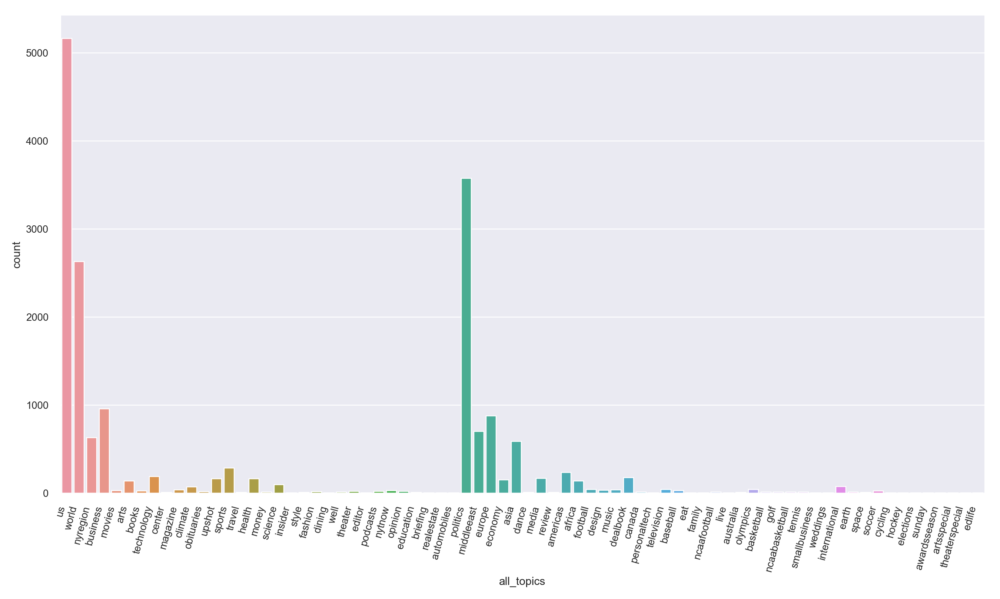

In [417]:
sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(15,9)})
sns.countplot(x=topicsdf["all_topics"], data=topicsdf)
plt.xticks(rotation=75, horizontalalignment='right')
plt.tight_layout()
sns.despine()

In [ ]:
fig, ax = plt.subplots(1,2)
sns.set(rc={'figure.figsize':(30,25)})
sns.countplot(nytimes['topic0'], ax=ax[0])
ax_twin = ax.twinx()

sns.countplot(nytimes['topic1'], ax=ax[1])
plt.xticks(rotation=75, horizontalalignment='right')
fig.show()

## EDA - Try it out on one thing

In [ ]:
# First, try code out with ONE row in perfect format!

In [350]:
# TRYING IT OUT
nlp = spacy.load('en_core_web_lg') # loading the language model 
doc = nlp(nytimes['content'][0])

In [348]:
nlp.pipe_names

['tagger', 'parser', 'ner']

In [349]:
doc

WASHINGTON — During a night of heavy drinking at an upscale London bar in May 2016, George Papadopoulos, a young foreign policy adviser to the Trump campaign, made a startling revelation to Australia’s top diplomat in Britain: Russia had political dirt on Hillary Clinton. About three weeks earlier, Mr. Papadopoulos had been told that Moscow had thousands of emails that would embarrass Mrs. Clinton, apparently stolen in an effort to try to damage her campaign. Exactly how much Mr. Papadopoulos said that night at the Kensington Wine Rooms with the Australian, Alexander Downer, is unclear. But two months later, when leaked Democratic emails began appearing online, Australian officials passed the information about Mr. Papadopoulos to their American counterparts, according to four current and former American and foreign officials with direct knowledge of the Australians’ role. The hacking and the revelation that a member of the Trump campaign may have had inside information about it were dr

In [346]:
sentences = list(doc.sents) 

In [ ]:
displacy.serve(sentences, style="dep")

/Users/lorajohns/anaconda3/lib/python3.7/runpy.py:193: UserWarning: [W011] It looks like you're calling displacy.serve from within a Jupyter notebook or a similar environment. This likely means you're already running a local web server, so there's no need to make displaCy start another one. Instead, you should be able to replace displacy.serve with displacy.render to show the visualization.
  "__main__", mod_spec)



Using the 'dep' visualizer
Serving on http://0.0.0.0:5000 ...



In [ ]:
displacy.render(doc, style="ent")

In [ ]:
for token in doc: 
    print(f"TOKEN: {token}\t\t\t POS:{token.pos_}")

In [ ]:
span = doc[0:15]
span[9].is_stop # "an"
span[1].pos_

In [ ]:
def count_stops(doc):
    stops = []
    count = 0
    for token in doc:
        if token.is_stop == True:
            stops.append(token.text)
            count += 1
    print(f"NUMBER OF STOPS: {count}")
    print(f"STOP WORDS: {set(stops)}")
count_stops(doc)

# Remove stopwords

In [39]:
nlp = spacy.load('en_core_web_lg')

stopwords = spacy.lang.en.STOP_WORDS
stop_list = ["Mr.","Mrs.","Ms.","say","WASHINGTON","'s"]
nlp.Defaults.stop_words.update(stop_list)

In [40]:
def update_stop_words(new_word_list):
    for lex in new_word_list:
         #if lex not in spacy.lang.en.STOP_WORDS:
        nlp.Defaults.stop_words.update(lex)
#     for word in STOP_WORDS:
#         lexeme = nlp.vocab[word]
#         lexeme.is_stop = True

    for word in nlp.Defaults.stop_words:
        for w in (word, word[0].upper() + word[1:], word.upper()):
            lexeme = nlp.vocab[w]
            lexeme.is_stop = True

In [41]:
update_stop_words(stop_list)

In [42]:
for word in stop_list:
    print(nlp.vocab[word].is_stop)

True
True
True
True
True
True


In [43]:
def cleaner(doc):
    doc = [token.text for token in doc if (not token.is_stop and not token.is_punct)]
    doc = u' '.join(doc)
    return nlp.make_doc(doc)

nlp.add_pipe(cleaner, name="cleaner", first="true")

In [44]:
doc = nlp(nytimes['content'][0])
with open('preprocess.pickle', 'wb') as f:
    pickle.dump(nlp, f)

In [45]:
for token in doc:
    print(f"TOKEN: {token}\t\tPOS: {token.pos_}")

TOKEN: night		POS: NOUN
TOKEN: heavy		POS: ADJ
TOKEN: drinking		POS: NOUN
TOKEN: upscale		POS: ADJ
TOKEN: London		POS: PROPN
TOKEN: bar		POS: NOUN
TOKEN: 2016		POS: NUM
TOKEN: George		POS: PROPN
TOKEN: Papadopoulos		POS: PROPN
TOKEN: young		POS: ADJ
TOKEN: foreign		POS: ADJ
TOKEN: policy		POS: NOUN
TOKEN: adviser		POS: NOUN
TOKEN: Trump		POS: PROPN
TOKEN: campaign		POS: NOUN
TOKEN: startling		POS: ADJ
TOKEN: revelation		POS: NOUN
TOKEN: Australia		POS: PROPN
TOKEN: diplomat		POS: NOUN
TOKEN: Britain		POS: PROPN
TOKEN: Russia		POS: PROPN
TOKEN: political		POS: ADJ
TOKEN: dirt		POS: NOUN
TOKEN: Hillary		POS: PROPN
TOKEN: Clinton		POS: PROPN
TOKEN: weeks		POS: NOUN
TOKEN: earlier		POS: ADV
TOKEN: Papadopoulos		POS: PROPN
TOKEN: told		POS: VERB
TOKEN: Moscow		POS: PROPN
TOKEN: thousands		POS: NOUN
TOKEN: emails		POS: NOUN
TOKEN: embarrass		POS: VERB
TOKEN: Clinton		POS: PROPN
TOKEN: apparently		POS: ADV
TOKEN: stolen		POS: VERB
TOKEN: effort		POS: NOUN
TOKEN: try		POS: VERB
TOKEN: damage		

In [46]:
doc = nlp(nytimes['content'][0])
doc

night heavy drinking upscale London bar 2016 George Papadopoulos young foreign policy adviser Trump campaign startling revelation Australia diplomat Britain Russia political dirt Hillary Clinton weeks earlier Papadopoulos told Moscow thousands emails embarrass Clinton apparently stolen effort try damage campaign Exactly Papadopoulos said night Kensington Wine Rooms Australian Alexander Downer unclear months later leaked Democratic emails began appearing online Australian officials passed information Papadopoulos American counterparts according current American foreign officials direct knowledge Australians role hacking revelation member Trump campaign inside information driving factors led F.B.I. open investigation July 2016 Russia attempts disrupt election President Trump associates conspired Papadopoulos pleaded guilty lying F.B.I. cooperating witness improbable match set blaze consumed year Trump administration saga tale Trump campaign miniature brash boastful underqualified exceede

# Bag of Words

In [311]:
# load the nlp preprocessor
with open('preprocess.pickle', 'rb') as f:
    nlp = pickle.load(f)

AttributeError: Can't get attribute 'cleaner' on <module '__main__'>

In [50]:
def lemmatizer(doc):
    doc = [token.lemma_ for token in doc if not token.lemma_ == '-PRON-']
    doc = u' '.join(doc)
    return nlp.make_doc(doc)

nlp.add_pipe(lemmatizer, 'lemmatizer', after='tagger')

## Convert spaCy to text and add to DataFrame for sklearn and gensim

In [51]:
# VERY BIG AND DANGEROUS CELL TO RUN
# DO NOT DO IT
# SERIOUSLY

with open('preprocess.pickle', 'rb') as f:
    nlp = pickle.load(f)
    
nlp.add_pipe(lemmatizer,name='lemmatizer',after='ner')
nlp.pipe_names

# pickle this nlp pipeline
with open('all_pipes.pickle', 'wb') as f:
    pickle.dump(nlp, f)
    
docs = nytimes['content'].tolist()
spacy_docs = []

for doc in tqdm_notebook(nlp.pipe(docs)):    
    doc = [token.text for token in doc]
    doc = u' '.join(doc)
    spacy_docs.append(nlp.make_doc(doc))
    
spacy_df = pd.DataFrame([]).append([spacy_docs]).T
spacy_df.columns = ['spacy_docs']

# DO NOT SKIP UNLESS YOU WANT NANS

spacy_df.reset_index(drop=True, inplace=True)
nytimes.reset_index(drop=True, inplace=True)

pd.concat([nytimes, spacy_df], axis=1)
# import os
# nytimes.to_pickle('nytimes_spacy.pickle')
# nytimes.to_csv('nytimes_spacy.csv')

KeyboardInterrupt: 

In [7]:
# from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
# analyzer = SentimentIntensityAnalyzer()
# 
# nytimes.drop(['sentiment'], axis=1, inplace=True)

In [337]:
# nytimes['sentiment'] = dataframe['Keywords'].apply(lambda x: analyzer.polarity_scores(x))

In [338]:
nytimes

,title,author,content,date,year,month,front_page,url,date_counter,topic0,topic1,spacy_docs,sentiment
0,"How the Russia Inquiry Began: A Campaign Aide,...",Sharon LaFraniere,WASHINGTON — During a night of heavy drinking ...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/us/politics...,0_2018,us,politics,"(night, heavy, drinking, upscale, London, bar,...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
1,"For Trump, a Year of Reinventing the Presidenc...",Peter Baker,WASHINGTON — When President Trump meets with a...,2017-12-31,2017.0,12.0,True,https://www.nytimes.com/2017/12/31/us/politics...,0_2018,us,politics,"(President, Trump, meet, aide, discuss, policy...","{'neg': 0.0, 'neu': 0.678, 'pos': 0.322, 'comp..."
2,The U.S. Has Pummeled Al Qaeda in Yemen. But t...,Eric Schmitt,"MANAMA, Bahrain — The United States has triple...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/world/middl...,0_2018,world,middleeast,"(MANAMA, Bahrain, United, States, triple, numb...","{'neg': 0.494, 'neu': 0.506, 'pos': 0.0, 'comp..."
3,Why an Upstate Prisoner With a History of Esca...,William K. Rashbaum,The plan sounds ingenious. Remove two small se...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/da...,0_2018,nyregion,NaN,"(plan, sound, ingenious, remove, small, securi...","{'neg': 0.568, 'neu': 0.432, 'pos': 0.0, 'comp..."
4,"In Fire-Scarred Bronx Neighborhood, a World of...",Rick Rojas,"Even on a nose-numbingly cold morning, familie...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/br...,0_2018,nyregion,NaN,"(nose, numbingly, cold, morning, family, sidew...","{'neg': 0.47, 'neu': 0.53, 'pos': 0.0, 'compou..."
5,"For Trump, a Year of Reinventing the Presidenc...",Peter Baker,WASHINGTON — When President Trump meets with a...,2017-12-31,2017.0,12.0,False,https://www.nytimes.com/2017/12/31/us/politics...,0_2018,us,politics,"(President, Trump, meet, aide, discuss, policy...","{'neg': 0.0, 'neu': 0.678, 'pos': 0.322, 'comp..."
6,Rouhani Urges Calm in Iran as Protests Continu...,Martin Fackler,After four days of rare protests that shook Ir...,2017-12-31,2017.0,12.0,False,https://www.nytimes.com/2017/12/31/world/middl...,0_2018,world,middleeast,"(day, rare, protest, shake, Iran, President, H...","{'neg': 0.0, 'neu': 0.763, 'pos': 0.237, 'comp..."
7,"Colorado Gunman Shoots 5 Officers Near Denver,...",Christopher Mele,It began as a predawn call for the police to a...,2017-12-31,2017.0,12.0,False,https://www.nytimes.com/2017/12/31/us/colorado...,0_2018,us,NaN,"(begin, predawn, police, disturbance, apartmen...","{'neg': 0.47, 'neu': 0.53, 'pos': 0.0, 'compou..."
8,"How the Russia Inquiry Began: A Campaign Aide,...",Sharon LaFraniere,WASHINGTON — During a night of heavy drinking ...,2017-12-30,2017.0,12.0,False,https://www.nytimes.com/2017/12/30/us/politics...,0_2018,us,politics,"(night, heavy, drinking, upscale, London, bar,...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
9,Republican Attacks on Mueller and F.B.I. Open ...,Nicholas Fandos,WASHINGTON — A growing campaign by President T...,2017-12-30,2017.0,12.0,False,https://www.nytimes.com/2017/12/30/us/politics...,0_2018,us,politics,"(grow, campaign, President, Trump, ardent, sup...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."


# LOAD LOAD LOAD

In [7]:
nytimes = pd.read_pickle("../nytimes_copy/nytimes_spacy.pickle")
nytimes.head()

,title,author,content,date,year,month,front_page,url,date_counter,topic0,topic1,spacy_docs
0,"How the Russia Inquiry Began: A Campaign Aide,...",Sharon LaFraniere,WASHINGTON — During a night of heavy drinking ...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/us/politics...,0_2018,us,politics,"(night, heavy, drinking, upscale, London, bar,..."
1,"For Trump, a Year of Reinventing the Presidenc...",Peter Baker,WASHINGTON — When President Trump meets with a...,2017-12-31,2017.0,12.0,True,https://www.nytimes.com/2017/12/31/us/politics...,0_2018,us,politics,"(President, Trump, meet, aide, discuss, policy..."
2,The U.S. Has Pummeled Al Qaeda in Yemen. But t...,Eric Schmitt,"MANAMA, Bahrain — The United States has triple...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/world/middl...,0_2018,world,middleeast,"(MANAMA, Bahrain, United, States, triple, numb..."
3,Why an Upstate Prisoner With a History of Esca...,William K. Rashbaum,The plan sounds ingenious. Remove two small se...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/da...,0_2018,nyregion,NaN,"(plan, sound, ingenious, remove, small, securi..."
4,"In Fire-Scarred Bronx Neighborhood, a World of...",Rick Rojas,"Even on a nose-numbingly cold morning, familie...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/br...,0_2018,nyregion,NaN,"(nose, numbingly, cold, morning, family, sidew..."


In [10]:
dataframe = pd.read_csv("../nytimes_copy/master_df_R2.csv")

In [11]:
to_add = dataframe[['Dominant_Topic', 'Topic_Perc_Contrib','Keywords']]

In [320]:
## MASTER DF

In [12]:
all_news = pd.concat([nytimes, to_add], axis=1)

In [13]:
topics = []
nytimes['topic0'].apply(lambda x: topics.append(x))
nytimes['topic1'].dropna().apply(lambda x: topics.append(x))
topics = set(topics)
len(topics)

pprint(topics)

{'africa',
 'americas',
 'arts',
 'artsspecial',
 'asia',
 'australia',
 'automobiles',
 'awardsseason',
 'baseball',
 'basketball',
 'books',
 'briefing',
 'business',
 'canada',
 'center',
 'climate',
 'cycling',
 'dance',
 'dealbook',
 'design',
 'dining',
 'earth',
 'eat',
 'economy',
 'editor',
 'edlife',
 'education',
 'elections',
 'europe',
 'family',
 'fashion',
 'football',
 'golf',
 'health',
 'hockey',
 'insider',
 'international',
 'live',
 'magazine',
 'media',
 'middleeast',
 'money',
 'movies',
 'music',
 'ncaabasketball',
 'ncaafootball',
 'nyregion',
 'nytnow',
 'obituaries',
 'olympics',
 'opinion',
 'personaltech',
 'podcasts',
 'politics',
 'realestate',
 'review',
 'science',
 'smallbusiness',
 'soccer',
 'space',
 'sports',
 'style',
 'sunday',
 'technology',
 'television',
 'tennis',
 'theater',
 'theaterspecial',
 'travel',
 'upshot',
 'us',
 'weddings',
 'well',
 'world'}


In [14]:
random = all_news.sample(frac=0.1)
random.head()
random = random[['title','content','Keywords','topic0','topic1']]
random.to_csv('sample.csv')

In [ ]:
#for index, row in all_news.iterrows():
    

In [149]:
test_topics = [['africa'],
['americas', 'canada'],
['arts', 'artsspecial', 'dance','design','style','theater',
 'theaterspecial'],
['asia',],
['australia',],
['automobiles'],
['awardsseason',],
['baseball','hockey','basketball','fashion','football','golf','ncaabasketball',
 'ncaafootball','olympics','soccer','sports', 'tennis'],
['books','review'],
['briefing','editor','insider','nytnow','opinion','sunday'], # general news; mixed bag
['business','dealbook','economy','money','smallbusiness'],
['climate','earth'],
['cycling',],
['dining','eat','live','magazine'],
['edlife','education'],
['elections'],
['europe'],
['family'],
['health','well'],
['international','world'],
['middleeast',],
['movies','media','music','podcasts',],
['nyregion'],
['obituaries'],
['personaltech','technology'],
['politics'],
['realestate'],
['science','space'],
['travel'],
['upshot'],
['us'],
['weddings'],
['television']]

In [14]:
def to_text(doc, strings=False):
    if not strings:
        return [token.text for token in doc if not token.is_stop]
    else:
        return u" ".join([token.text for token in doc if not token.is_stop])

In [15]:
nytimes['clean_strings'] = nytimes['spacy_docs'].apply(lambda x: to_text(x))

In [13]:
# doc_list for conversion because we didn't know about goldparse
doc_list = []
for index, row in tqdm_notebook(nytimes.iterrows()):
    new = []
    for word in iter(row['clean_strings']):
        new.append(word)
    doc_list.append(new)
    

# Create Dictionary

id2word = gensim.corpora.Dictionary(doc_list)

# Create Corpus
texts = doc_list

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

In [57]:
len(corpus)

10731

In [ ]:
# To reload them:
# dictionary = corpora.Dictionary.load('dictionary.dict')
# corpus = corpora.MmCorpus('corpus.mm')

In [ ]:
# To reload them:
# bow_dictionary = corpora.Dictionary.load('bow_dictionary.dict')
# bow_corpus = corpora.MmCorpus('bow_corpus.mm')

In [62]:
for doc in corpus:
    for ix, freq in doc:
        print(f"WORD: {id2word[ix]}\tFREQ: {freq}\n")   
        time.sleep(0.1)

WORD: 2016	FREQ: 10

WORD: 2017	FREQ: 1

WORD: 27	FREQ: 1

WORD: 28-year	FREQ: 1

WORD: 4	FREQ: 1

WORD: Abdel	FREQ: 1

WORD: Affairs	FREQ: 1

WORD: Alabama	FREQ: 1

WORD: Alexander	FREQ: 1

WORD: America	FREQ: 1

WORD: American	FREQ: 1

WORD: April	FREQ: 2

WORD: Assembly	FREQ: 1

WORD: Australia	FREQ: 1

WORD: Australian	FREQ: 1

WORD: Australians	FREQ: 3

WORD: Bannon	FREQ: 3

WORD: Belarus	FREQ: 1

WORD: Ben	FREQ: 1

WORD: Brennan	FREQ: 1

WORD: Britain	FREQ: 1

WORD: C.I.A.	FREQ: 1

WORD: Cameron	FREQ: 2

WORD: Carson	FREQ: 1

WORD: Carter	FREQ: 1

WORD: Chamber	FREQ: 1

WORD: Chicago	FREQ: 1

WORD: Christopher	FREQ: 1

WORD: Clinton	FREQ: 4

WORD: Clovis	FREQ: 5

WORD: Club	FREQ: 1

WORD: Commerce	FREQ: 1

WORD: Committee	FREQ: 1

WORD: Congress	FREQ: 3

WORD: Council	FREQ: 1

WORD: David	FREQ: 1

WORD: Democratic	FREQ: 1

WORD: Democrats	FREQ: 1

WORD: Department	FREQ: 1

WORD: Discussion	FREQ: 1

WORD: Downer	FREQ: 3

WORD: Egypt	FREQ: 1

WORD: Embassy	FREQ: 2

WORD: Europe	FRE

WORD: initially	FREQ: 1

WORD: inquiry	FREQ: 2

WORD: inside	FREQ: 2

WORD: insight	FREQ: 1

WORD: insignificant	FREQ: 1

WORD: insist	FREQ: 1

WORD: instance	FREQ: 1

WORD: instead	FREQ: 1

WORD: intelligence	FREQ: 2

WORD: intently	FREQ: 1

WORD: interaction	FREQ: 1

WORD: interest	FREQ: 1

WORD: interested	FREQ: 1

WORD: interesting	FREQ: 1

WORD: intermediary	FREQ: 1

WORD: interview	FREQ: 5

WORD: introduce	FREQ: 1

WORD: investigate	FREQ: 2

WORD: investigation	FREQ: 9

WORD: investigator	FREQ: 1

WORD: israeli	FREQ: 1

WORD: issue	FREQ: 1

WORD: issuing	FREQ: 1

WORD: job	FREQ: 2

WORD: joint	FREQ: 1

WORD: journalist	FREQ: 2

WORD: justification	FREQ: 1

WORD: kind	FREQ: 1

WORD: know	FREQ: 3

WORD: knowledge	FREQ: 1

WORD: largely	FREQ: 1

WORD: latch	FREQ: 1

WORD: late	FREQ: 2

WORD: later	FREQ: 1

WORD: lawmaker	FREQ: 1

WORD: lawyer	FREQ: 1

WORD: lead	FREQ: 1

WORD: leader	FREQ: 1

WORD: leak	FREQ: 1

WORD: learn	FREQ: 1

WORD: level	FREQ: 4

WORD: leverage	FREQ: 1

WORD:

WORD: investigator	FREQ: 1

WORD: issue	FREQ: 1

WORD: journalist	FREQ: 1

WORD: kind	FREQ: 2

WORD: lawmaker	FREQ: 2

WORD: lawyer	FREQ: 2

WORD: lead	FREQ: 2

WORD: level	FREQ: 1

WORD: lie	FREQ: 1

WORD: like	FREQ: 3

WORD: limit	FREQ: 1

WORD: long	FREQ: 3

WORD: major	FREQ: 1

WORD: man	FREQ: 4

WORD: meet	FREQ: 2

WORD: member	FREQ: 1

WORD: multiple	FREQ: 1

WORD: new	FREQ: 3

WORD: normally	FREQ: 1

WORD: office	FREQ: 7

WORD: official	FREQ: 2

WORD: open	FREQ: 1

WORD: past	FREQ: 1

WORD: people	FREQ: 11

WORD: play	FREQ: 2

WORD: player	FREQ: 2

WORD: point	FREQ: 6

WORD: policy	FREQ: 4

WORD: political	FREQ: 5

WORD: politician	FREQ: 1

WORD: position	FREQ: 1

WORD: possible	FREQ: 3

WORD: presidency	FREQ: 20

WORD: president	FREQ: 37

WORD: presidential	FREQ: 7

WORD: professor	FREQ: 1

WORD: proposal	FREQ: 1

WORD: prove	FREQ: 1

WORD: provoke	FREQ: 1

WORD: public	FREQ: 4

WORD: publicly	FREQ: 1

WORD: push	FREQ: 2

WORD: question	FREQ: 4

WORD: rally	FREQ: 1

WORD: recei

WORD: eliminate	FREQ: 1

WORD: elite	FREQ: 2

WORD: embolden	FREQ: 1

WORD: empathy	FREQ: 1

WORD: empower	FREQ: 1

WORD: enact	FREQ: 1

WORD: endorse	FREQ: 1

WORD: enemy	FREQ: 2

WORD: energize	FREQ: 1

WORD: entrenched	FREQ: 1

WORD: entry	FREQ: 1

WORD: equal	FREQ: 1

WORD: era	FREQ: 1

WORD: eschew	FREQ: 1

WORD: essentially	FREQ: 2

WORD: establishment	FREQ: 3

WORD: ethic	FREQ: 2

WORD: everyday	FREQ: 1

WORD: examine	FREQ: 1

WORD: exception	FREQ: 1

WORD: exclaim	FREQ: 1

WORD: expand	FREQ: 1

WORD: expansion	FREQ: 1

WORD: expect	FREQ: 3

WORD: experiment	FREQ: 1

WORD: express	FREQ: 1

WORD: fact	FREQ: 1

WORD: faction	FREQ: 1

WORD: fairly	FREQ: 1

WORD: fake	FREQ: 2

WORD: fall	FREQ: 1

WORD: fare	FREQ: 1

WORD: fashion	FREQ: 1

WORD: fat	FREQ: 1

WORD: favor	FREQ: 2

WORD: fear	FREQ: 1

WORD: feel	FREQ: 3

WORD: fierce	FREQ: 1

WORD: fight	FREQ: 2

WORD: fine	FREQ: 1

WORD: fireside	FREQ: 1

WORD: firing	FREQ: 1

WORD: fix	FREQ: 1

WORD: foe	FREQ: 1

WORD: force	FREQ: 2



WORD: unconventional	FREQ: 2

WORD: unhinged	FREQ: 1

WORD: unimaginable	FREQ: 1

WORD: unity	FREQ: 1

WORD: unpopular	FREQ: 2

WORD: unto	FREQ: 1

WORD: unvarnished	FREQ: 1

WORD: unwieldy	FREQ: 1

WORD: upend	FREQ: 1

WORD: use	FREQ: 6

WORD: utterly	FREQ: 1

WORD: vanity	FREQ: 1

WORD: vantage	FREQ: 2

WORD: vary	FREQ: 1

WORD: vehicle	FREQ: 1

WORD: veneer	FREQ: 1

WORD: verve	FREQ: 1

WORD: vet	FREQ: 1

WORD: voice	FREQ: 1

WORD: vote	FREQ: 1

WORD: voter	FREQ: 1

WORD: wacky	FREQ: 1

WORD: wage	FREQ: 3

WORD: walking	FREQ: 1

WORD: war	FREQ: 5

WORD: warfare	FREQ: 1

WORD: warn	FREQ: 2

WORD: weak	FREQ: 1

WORD: weakness	FREQ: 1

WORD: weapon	FREQ: 3

WORD: white	FREQ: 1

WORD: wide	FREQ: 1

WORD: willingness	FREQ: 1

WORD: wish	FREQ: 1

WORD: wonder	FREQ: 1

WORD: worker	FREQ: 2

WORD: world	FREQ: 1

WORD: worry	FREQ: 3

WORD: wrong	FREQ: 2

WORD: yacht	FREQ: 1

WORD: yeah	FREQ: 1

WORD: 2016	FREQ: 2

WORD: April	FREQ: 1

WORD: C.I.A.	FREQ: 2

WORD: Council	FREQ: 1

WORD: David	

WORD: execute	FREQ: 1

WORD: exist	FREQ: 1

WORD: explain	FREQ: 1

WORD: exploit	FREQ: 2

WORD: external	FREQ: 1

WORD: extraordinarily	FREQ: 1

WORD: family	FREQ: 1

WORD: fated	FREQ: 1

WORD: ferocious	FREQ: 1

WORD: fifth	FREQ: 1

WORD: fighter	FREQ: 1

WORD: firefight	FREQ: 1

WORD: flee	FREQ: 1

WORD: formally	FREQ: 1

WORD: freedom	FREQ: 1

WORD: frustrating	FREQ: 1

WORD: function	FREQ: 1

WORD: grind	FREQ: 1

WORD: grip	FREQ: 1

WORD: ground	FREQ: 1

WORD: hamper	FREQ: 1

WORD: haven	FREQ: 1

WORD: hearing	FREQ: 1

WORD: hierarchy	FREQ: 1

WORD: humanitarian	FREQ: 3

WORD: ill	FREQ: 1

WORD: infiltrate	FREQ: 1

WORD: insurgent	FREQ: 1

WORD: intensify	FREQ: 2

WORD: interior	FREQ: 1

WORD: interrogation	FREQ: 1

WORD: invent	FREQ: 1

WORD: key	FREQ: 1

WORD: kill	FREQ: 4

WORD: lack	FREQ: 3

WORD: land	FREQ: 1

WORD: laptop	FREQ: 1

WORD: large	FREQ: 4

WORD: laud	FREQ: 1

WORD: leadership	FREQ: 1

WORD: left	FREQ: 1

WORD: local	FREQ: 1

WORD: location	FREQ: 1

WORD: lose	FREQ

WORD: escape	FREQ: 13

WORD: escapee	FREQ: 1

WORD: eventually	FREQ: 3

WORD: excerpt	FREQ: 1

WORD: excrement	FREQ: 1

WORD: extra	FREQ: 1

WORD: face	FREQ: 1

WORD: facility	FREQ: 1

WORD: feed	FREQ: 1

WORD: fiber	FREQ: 1

WORD: flat	FREQ: 1

WORD: food	FREQ: 4

WORD: forward	FREQ: 1

WORD: girlfriend	FREQ: 3

WORD: grant	FREQ: 1

WORD: grate	FREQ: 1

WORD: green	FREQ: 1

WORD: hand	FREQ: 1

WORD: harm	FREQ: 1

WORD: hat	FREQ: 1

WORD: hole	FREQ: 1

WORD: house	FREQ: 1

WORD: hunger	FREQ: 2

WORD: indicate	FREQ: 1

WORD: infamous	FREQ: 1

WORD: ingenious	FREQ: 1

WORD: inmate	FREQ: 6

WORD: inspector	FREQ: 1

WORD: intense	FREQ: 1

WORD: jailer	FREQ: 1

WORD: ladder	FREQ: 1

WORD: lapse	FREQ: 1

WORD: lean	FREQ: 1

WORD: leather	FREQ: 1

WORD: leg	FREQ: 1

WORD: lessen	FREQ: 1

WORD: loosen	FREQ: 1

WORD: maintain	FREQ: 1

WORD: manacle	FREQ: 1

WORD: maximum	FREQ: 1

WORD: mechanical	FREQ: 1

WORD: medical	FREQ: 2

WORD: merit	FREQ: 1

WORD: mile	FREQ: 1

WORD: murder	FREQ: 1

WORD

WORD: beanie	FREQ: 1

WORD: black	FREQ: 1

WORD: blacken	FREQ: 1

WORD: blanket	FREQ: 2

WORD: block	FREQ: 5

WORD: bodega	FREQ: 1

WORD: body	FREQ: 1

WORD: borough	FREQ: 1

WORD: botánica	FREQ: 1

WORD: bouquet	FREQ: 1

WORD: breath	FREQ: 1

WORD: brick	FREQ: 2

WORD: brother	FREQ: 1

WORD: brown	FREQ: 1

WORD: burn	FREQ: 3

WORD: burner	FREQ: 1

WORD: bustle	FREQ: 1

WORD: buzz	FREQ: 1

WORD: campus	FREQ: 1

WORD: carbon	FREQ: 1

WORD: caretaker	FREQ: 1

WORD: catch	FREQ: 1

WORD: celebrate	FREQ: 1

WORD: century	FREQ: 1

WORD: chandelier	FREQ: 1

WORD: chaos	FREQ: 1

WORD: churn	FREQ: 1

WORD: class	FREQ: 2

WORD: cling	FREQ: 1

WORD: closed	FREQ: 1

WORD: clothe	FREQ: 1

WORD: coat	FREQ: 1

WORD: cold	FREQ: 1

WORD: community	FREQ: 1

WORD: company	FREQ: 3

WORD: comparison	FREQ: 2

WORD: condition	FREQ: 1

WORD: considerably	FREQ: 1

WORD: constant	FREQ: 1

WORD: cook	FREQ: 1

WORD: cooking	FREQ: 1

WORD: cordone	FREQ: 1

WORD: corner	FREQ: 3

WORD: crime	FREQ: 3

WORD: crowd	FRE

WORD: repeatedly	FREQ: 1

WORD: retire	FREQ: 2

WORD: rival	FREQ: 1

WORD: role	FREQ: 1

WORD: run	FREQ: 4

WORD: senior	FREQ: 2

WORD: serve	FREQ: 4

WORD: set	FREQ: 1

WORD: share	FREQ: 1

WORD: soft	FREQ: 2

WORD: speak	FREQ: 1

WORD: special	FREQ: 1

WORD: speech	FREQ: 1

WORD: spy	FREQ: 1

WORD: stay	FREQ: 1

WORD: suggest	FREQ: 1

WORD: summer	FREQ: 1

WORD: tale	FREQ: 1

WORD: talk	FREQ: 2

WORD: target	FREQ: 1

WORD: tell	FREQ: 2

WORD: time	FREQ: 10

WORD: try	FREQ: 2

WORD: ultimately	FREQ: 1

WORD: view	FREQ: 4

WORD: want	FREQ: 1

WORD: way	FREQ: 11

WORD: win	FREQ: 3

WORD: work	FREQ: 1

WORD: write	FREQ: 1

WORD: year	FREQ: 7

WORD:    	FREQ: 1

WORD: 1600	FREQ: 1

WORD: 200	FREQ: 1

WORD: 30	FREQ: 1

WORD: 34	FREQ: 1

WORD: 350	FREQ: 1

WORD: 40	FREQ: 1

WORD: 44	FREQ: 1

WORD: 45th	FREQ: 1

WORD: 469	FREQ: 1

WORD: 72	FREQ: 1

WORD: A.	FREQ: 2

WORD: Abraham	FREQ: 1

WORD: Alliance	FREQ: 1

WORD: Americans	FREQ: 1

WORD: Andy	FREQ: 1

WORD: Anne	FREQ: 1

WORD: Avenue	FR

WORD: forth	FREQ: 1

WORD: founder	FREQ: 1

WORD: frame	FREQ: 1

WORD: free	FREQ: 1

WORD: friend	FREQ: 1

WORD: frustrate	FREQ: 1

WORD: frustration	FREQ: 1

WORD: fuel	FREQ: 1

WORD: fully	FREQ: 2

WORD: gender	FREQ: 1

WORD: generally	FREQ: 3

WORD: generation	FREQ: 1

WORD: generosity	FREQ: 1

WORD: govern	FREQ: 1

WORD: governance	FREQ: 1

WORD: governor	FREQ: 1

WORD: gratitude	FREQ: 1

WORD: grievance	FREQ: 1

WORD: group	FREQ: 1

WORD: grudgingly	FREQ: 1

WORD: guardrail	FREQ: 1

WORD: guide	FREQ: 1

WORD: gusto	FREQ: 1

WORD: gut	FREQ: 2

WORD: guy	FREQ: 1

WORD: gyration	FREQ: 1

WORD: handle	FREQ: 2

WORD: happen	FREQ: 1

WORD: harder	FREQ: 1

WORD: hate	FREQ: 1

WORD: healthy	FREQ: 2

WORD: hear	FREQ: 1

WORD: hide	FREQ: 1

WORD: historian	FREQ: 1

WORD: history	FREQ: 1

WORD: hit	FREQ: 2

WORD: human	FREQ: 1

WORD: hurricane	FREQ: 1

WORD: idealism	FREQ: 1

WORD: ideological	FREQ: 1

WORD: impeachment	FREQ: 1

WORD: imperial	FREQ: 1

WORD: impose	FREQ: 1

WORD: inaccuracy	

WORD: Washington	FREQ: 1

WORD: accord	FREQ: 2

WORD: add	FREQ: 2

WORD: ago	FREQ: 1

WORD: american	FREQ: 1

WORD: appear	FREQ: 2

WORD: begin	FREQ: 1

WORD: chairman	FREQ: 1

WORD: channel	FREQ: 2

WORD: chief	FREQ: 1

WORD: client	FREQ: 1

WORD: closely	FREQ: 1

WORD: come	FREQ: 2

WORD: concern	FREQ: 1

WORD: confirm	FREQ: 2

WORD: day	FREQ: 3

WORD: describe	FREQ: 1

WORD: difficult	FREQ: 1

WORD: effort	FREQ: 1

WORD: election	FREQ: 2

WORD: email	FREQ: 1

WORD: emerge	FREQ: 1

WORD: especially	FREQ: 1

WORD: executive	FREQ: 1

WORD: far	FREQ: 1

WORD: fire	FREQ: 1

WORD: foreign	FREQ: 2

WORD: general	FREQ: 1

WORD: good	FREQ: 1

WORD: government	FREQ: 6

WORD: great	FREQ: 1

WORD: head	FREQ: 1

WORD: high	FREQ: 1

WORD: hope	FREQ: 2

WORD: important	FREQ: 1

WORD: improve	FREQ: 1

WORD: include	FREQ: 5

WORD: issue	FREQ: 1

WORD: later	FREQ: 1

WORD: lead	FREQ: 1

WORD: leader	FREQ: 5

WORD: like	FREQ: 4

WORD: limit	FREQ: 2

WORD: little	FREQ: 2

WORD: long	FREQ: 1

WORD: majo

WORD: child	FREQ: 1

WORD: come	FREQ: 2

WORD: describe	FREQ: 6

WORD: eager	FREQ: 1

WORD: emerge	FREQ: 1

WORD: end	FREQ: 1

WORD: exactly	FREQ: 1

WORD: exchange	FREQ: 2

WORD: fire	FREQ: 5

WORD: friendly	FREQ: 1

WORD: hold	FREQ: 1

WORD: include	FREQ: 1

WORD: interest	FREQ: 1

WORD: interview	FREQ: 2

WORD: investigation	FREQ: 1

WORD: job	FREQ: 1

WORD: kind	FREQ: 1

WORD: know	FREQ: 4

WORD: lead	FREQ: 3

WORD: like	FREQ: 2

WORD: man	FREQ: 2

WORD: meet	FREQ: 1

WORD: member	FREQ: 1

WORD: month	FREQ: 1

WORD: morning	FREQ: 1

WORD: multiple	FREQ: 1

WORD: night	FREQ: 2

WORD: occur	FREQ: 2

WORD: office	FREQ: 1

WORD: official	FREQ: 1

WORD: old	FREQ: 2

WORD: outline	FREQ: 1

WORD: past	FREQ: 1

WORD: people	FREQ: 1

WORD: point	FREQ: 1

WORD: position	FREQ: 1

WORD: provide	FREQ: 1

WORD: question	FREQ: 1

WORD: quiet	FREQ: 1

WORD: record	FREQ: 1

WORD: relation	FREQ: 1

WORD: run	FREQ: 1

WORD: serve	FREQ: 1

WORD: seven	FREQ: 2

WORD: statement	FREQ: 5

WORD: talk	FREQ:

WORD: Muslims	FREQ: 1

WORD: National	FREQ: 2

WORD: Nations	FREQ: 1

WORD: New	FREQ: 5

WORD: O.	FREQ: 1

WORD: October	FREQ: 1

WORD: Olga	FREQ: 1

WORD: Page	FREQ: 2

WORD: Papadopoulos	FREQ: 44

WORD: Petersburg	FREQ: 1

WORD: Polonskaya	FREQ: 4

WORD: President	FREQ: 3

WORD: Prime	FREQ: 1

WORD: Putin	FREQ: 4

WORD: Records	FREQ: 1

WORD: Robert	FREQ: 1

WORD: Rome	FREQ: 1

WORD: Rooms	FREQ: 1

WORD: Russia	FREQ: 12

WORD: Russian	FREQ: 1

WORD: Russians	FREQ: 4

WORD: S.	FREQ: 2

WORD: Sam	FREQ: 1

WORD: Security	FREQ: 1

WORD: September	FREQ: 1

WORD: Sergei	FREQ: 1

WORD: Sessions	FREQ: 1

WORD: Sisi	FREQ: 2

WORD: St.	FREQ: 1

WORD: States	FREQ: 1

WORD: Steele	FREQ: 3

WORD: Stephen	FREQ: 2

WORD: T.	FREQ: 1

WORD: Times	FREQ: 5

WORD: Timofeev	FREQ: 3

WORD: Trump	FREQ: 38

WORD: United	FREQ: 2

WORD: V.	FREQ: 1

WORD: Valdai	FREQ: 1

WORD: Vladimir	FREQ: 1

WORD: Washington	FREQ: 2

WORD: White	FREQ: 2

WORD: Wine	FREQ: 1

WORD: Year	FREQ: 3

WORD: York	FREQ: 2

WORD: able

WORD: occur	FREQ: 1

WORD: odds	FREQ: 1

WORD: offering	FREQ: 1

WORD: office	FREQ: 1

WORD: official	FREQ: 12

WORD: officially	FREQ: 1

WORD: old	FREQ: 1

WORD: online	FREQ: 1

WORD: op	FREQ: 1

WORD: open	FREQ: 6

WORD: opening	FREQ: 1

WORD: operation	FREQ: 3

WORD: organization	FREQ: 1

WORD: outline	FREQ: 1

WORD: overstate	FREQ: 1

WORD: pair	FREQ: 1

WORD: paper	FREQ: 1

WORD: participant	FREQ: 1

WORD: particular	FREQ: 1

WORD: partly	FREQ: 2

WORD: pass	FREQ: 2

WORD: past	FREQ: 2

WORD: people	FREQ: 2

WORD: peripheral	FREQ: 1

WORD: pick	FREQ: 1

WORD: play	FREQ: 3

WORD: player	FREQ: 1

WORD: plead	FREQ: 1

WORD: pleased	FREQ: 1

WORD: point	FREQ: 1

WORD: policy	FREQ: 9

WORD: political	FREQ: 2

WORD: politician	FREQ: 1

WORD: poor	FREQ: 1

WORD: portfolio	FREQ: 1

WORD: portrait	FREQ: 1

WORD: position	FREQ: 1

WORD: possibility	FREQ: 2

WORD: possible	FREQ: 2

WORD: practice	FREQ: 1

WORD: precaution	FREQ: 1

WORD: presidency	FREQ: 1

WORD: president	FREQ: 3

WORD: pres

WORD: guy	FREQ: 1

WORD: handle	FREQ: 2

WORD: happen	FREQ: 1

WORD: hear	FREQ: 1

WORD: independent	FREQ: 1

WORD: institution	FREQ: 2

WORD: law	FREQ: 12

WORD: leave	FREQ: 1

WORD: life	FREQ: 1

WORD: line	FREQ: 1

WORD: look	FREQ: 1

WORD: medium	FREQ: 1

WORD: news	FREQ: 2

WORD: notable	FREQ: 1

WORD: opposition	FREQ: 1

WORD: order	FREQ: 1

WORD: outright	FREQ: 1

WORD: paint	FREQ: 2

WORD: party	FREQ: 3

WORD: pen	FREQ: 1

WORD: permanent	FREQ: 1

WORD: punish	FREQ: 1

WORD: release	FREQ: 1

WORD: remain	FREQ: 2

WORD: remove	FREQ: 1

WORD: republican	FREQ: 5

WORD: research	FREQ: 1

WORD: right	FREQ: 2

WORD: short	FREQ: 1

WORD: small	FREQ: 1

WORD: sort	FREQ: 1

WORD: strike	FREQ: 1

WORD: strong	FREQ: 1

WORD: supporter	FREQ: 2

WORD: thing	FREQ: 4

WORD: think	FREQ: 2

WORD: unpopular	FREQ: 1

WORD: use	FREQ: 1

WORD: wage	FREQ: 1

WORD: war	FREQ: 1

WORD: world	FREQ: 1

WORD: worry	FREQ: 1

WORD: December	FREQ: 2

WORD: J.	FREQ: 2

WORD: Mark	FREQ: 1

WORD: analyst	FREQ: 

WORD: relationship	FREQ: 1

WORD: represent	FREQ: 2

WORD: representative	FREQ: 1

WORD: respond	FREQ: 1

WORD: reveal	FREQ: 1

WORD: security	FREQ: 2

WORD: senator	FREQ: 1

WORD: serve	FREQ: 1

WORD: set	FREQ: 1

WORD: similar	FREQ: 2

WORD: speak	FREQ: 1

WORD: story	FREQ: 3

WORD: suggest	FREQ: 4

WORD: support	FREQ: 2

WORD: target	FREQ: 2

WORD: tell	FREQ: 2

WORD: thousand	FREQ: 1

WORD: time	FREQ: 2

WORD: tip	FREQ: 1

WORD: try	FREQ: 1

WORD: want	FREQ: 3

WORD: way	FREQ: 1

WORD: week	FREQ: 2

WORD: woman	FREQ: 8

WORD: work	FREQ: 4

WORD: write	FREQ: 2

WORD: year	FREQ: 1

WORD: young	FREQ: 1

WORD: Bill	FREQ: 2

WORD: H.	FREQ: 1

WORD: Johnson	FREQ: 1

WORD: November	FREQ: 1

WORD: Richard	FREQ: 1

WORD: Senate	FREQ: 2

WORD: Twitter	FREQ: 2

WORD: accept	FREQ: 1

WORD: accuse	FREQ: 5

WORD: action	FREQ: 1

WORD: advantage	FREQ: 1

WORD: air	FREQ: 1

WORD: allow	FREQ: 1

WORD: anger	FREQ: 1

WORD: appeal	FREQ: 1

WORD: attention	FREQ: 1

WORD: away	FREQ: 1

WORD: backlash	F

WORD: raft	FREQ: 1

WORD: raiser	FREQ: 1

WORD: raising	FREQ: 1

WORD: rape	FREQ: 1

WORD: refer	FREQ: 1

WORD: refund	FREQ: 1

WORD: refunded	FREQ: 1

WORD: relocation	FREQ: 2

WORD: repercussion	FREQ: 1

WORD: request	FREQ: 1

WORD: requirement	FREQ: 1

WORD: resonate	FREQ: 1

WORD: roil	FREQ: 1

WORD: secretly	FREQ: 1

WORD: seize	FREQ: 1

WORD: semiregular	FREQ: 1

WORD: settlement	FREQ: 5

WORD: sexual	FREQ: 22

WORD: sexually	FREQ: 2

WORD: shocked	FREQ: 1

WORD: shortly	FREQ: 1

WORD: silence	FREQ: 1

WORD: skepticism	FREQ: 1

WORD: solicit	FREQ: 1

WORD: solicitation	FREQ: 1

WORD: somebody	FREQ: 1

WORD: sorely	FREQ: 1

WORD: spark	FREQ: 1

WORD: stalwart	FREQ: 1

WORD: suit	FREQ: 2

WORD: suite	FREQ: 2

WORD: super	FREQ: 1

WORD: surface	FREQ: 1

WORD: suspicion	FREQ: 1

WORD: sweeten	FREQ: 1

WORD: switch	FREQ: 1

WORD: theory	FREQ: 1

WORD: tint	FREQ: 1

WORD: unaware	FREQ: 1

WORD: unearth	FREQ: 1

WORD: unlawful	FREQ: 1

WORD: unlikely	FREQ: 1

WORD: unsophisticated	FREQ:

WORD: despite	FREQ: 1

WORD: economy	FREQ: 2

WORD: engage	FREQ: 1

WORD: hard	FREQ: 2

WORD: isolate	FREQ: 1

WORD: money	FREQ: 1

WORD: oil	FREQ: 2

WORD: shut	FREQ: 1

WORD: unemployment	FREQ: 1

WORD: urge	FREQ: 3

WORD: 100	FREQ: 1

WORD: Police	FREQ: 2

WORD: arrive	FREQ: 1

WORD: complex	FREQ: 2

WORD: deputy	FREQ: 1

WORD: gear	FREQ: 1

WORD: home	FREQ: 2

WORD: identify	FREQ: 3

WORD: kid	FREQ: 1

WORD: mix	FREQ: 1

WORD: require	FREQ: 2

WORD: safety	FREQ: 1

WORD: unit	FREQ: 1

WORD: wife	FREQ: 2

WORD: 16	FREQ: 2

WORD: Party	FREQ: 1

WORD: assume	FREQ: 1

WORD: chill	FREQ: 1

WORD: colleague	FREQ: 2

WORD: cut	FREQ: 2

WORD: defend	FREQ: 1

WORD: fellow	FREQ: 1

WORD: involve	FREQ: 1

WORD: launch	FREQ: 1

WORD: loyalty	FREQ: 1

WORD: ratchet	FREQ: 1

WORD: reputation	FREQ: 1

WORD: stop	FREQ: 6

WORD: typically	FREQ: 1

WORD: wind	FREQ: 1

WORD: 2007	FREQ: 2

WORD: Institute	FREQ: 1

WORD: amid	FREQ: 1

WORD: arrangement	FREQ: 1

WORD: date	FREQ: 1

WORD: drop	FREQ: 1

WO

WORD: 2016	FREQ: 4

WORD: Affairs	FREQ: 4

WORD: David	FREQ: 1

WORD: Department	FREQ: 3

WORD: House	FREQ: 1

WORD: Michael	FREQ: 2

WORD: New	FREQ: 1

WORD: Times	FREQ: 1

WORD: York	FREQ: 1

WORD: able	FREQ: 1

WORD: accord	FREQ: 3

WORD: account	FREQ: 1

WORD: add	FREQ: 2

WORD: administration	FREQ: 6

WORD: ago	FREQ: 1

WORD: agree	FREQ: 1

WORD: ahead	FREQ: 1

WORD: appear	FREQ: 5

WORD: ask	FREQ: 3

WORD: attempt	FREQ: 1

WORD: begin	FREQ: 5

WORD: case	FREQ: 3

WORD: cast	FREQ: 1

WORD: central	FREQ: 1

WORD: charge	FREQ: 1

WORD: chief	FREQ: 3

WORD: come	FREQ: 1

WORD: concern	FREQ: 1

WORD: create	FREQ: 3

WORD: critical	FREQ: 2

WORD: current	FREQ: 1

WORD: datum	FREQ: 2

WORD: day	FREQ: 3

WORD: decide	FREQ: 1

WORD: decision	FREQ: 3

WORD: deny	FREQ: 4

WORD: director	FREQ: 4

WORD: disagree	FREQ: 1

WORD: document	FREQ: 1

WORD: early	FREQ: 1

WORD: effort	FREQ: 2

WORD: figure	FREQ: 2

WORD: goal	FREQ: 1

WORD: good	FREQ: 2

WORD: government	FREQ: 2

WORD: head	FREQ: 1


WORD: costly	FREQ: 1

WORD: counter	FREQ: 1

WORD: crash	FREQ: 1

WORD: cripple	FREQ: 1

WORD: dad	FREQ: 1

WORD: decrease	FREQ: 1

WORD: deficiency	FREQ: 1

WORD: dehydrated	FREQ: 1

WORD: delay	FREQ: 1

WORD: demote	FREQ: 1

WORD: denial	FREQ: 1

WORD: detrimental	FREQ: 1

WORD: diagnosis	FREQ: 1

WORD: discharge	FREQ: 1

WORD: doctor	FREQ: 19

WORD: dysfunctional	FREQ: 1

WORD: easily	FREQ: 1

WORD: emergency	FREQ: 5

WORD: enforce	FREQ: 1

WORD: exclusion	FREQ: 1

WORD: extremely	FREQ: 2

WORD: fleck	FREQ: 1

WORD: fluid	FREQ: 1

WORD: focus	FREQ: 2

WORD: gap	FREQ: 1

WORD: grade	FREQ: 2

WORD: health	FREQ: 5

WORD: hobble	FREQ: 1

WORD: hospice	FREQ: 2

WORD: hospitalist	FREQ: 1

WORD: hypervolemia	FREQ: 1

WORD: improvement	FREQ: 1

WORD: inaccurate	FREQ: 1

WORD: indicator	FREQ: 2

WORD: inefficiency	FREQ: 1

WORD: infection	FREQ: 1

WORD: inpatient	FREQ: 1

WORD: lab	FREQ: 1

WORD: languish	FREQ: 1

WORD: lift	FREQ: 1

WORD: limited	FREQ: 1

WORD: living	FREQ: 1

WORD: mad	FRE

KeyboardInterrupt: 

# LDA Topic modeling

In [64]:
# One model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=20, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

In [66]:
# save
with open('lda_model.pickle', 'wb') as f:
    pickle.dump(lda_model, f)

In [266]:
# open 
with open('lda_model.pickle', 'rb') as f:
    lda_model = pickle.load(f)

In [9]:
# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.036*"woman" + 0.010*"black" + 0.009*"write" + 0.009*"New" + 0.009*"gay" + '
  '0.008*"church" + 0.008*"man" + 0.007*"York" + 0.007*"play" + 0.007*"book"'),
 (1,
  '0.020*"police" + 0.015*"officer" + 0.012*"man" + 0.012*"family" + '
  '0.011*"school" + 0.011*"people" + 0.008*"child" + 0.008*"gun" + '
  '0.007*"shoot" + 0.007*"student"'),
 (2,
  '0.100*"Russia" + 0.087*"russian" + 0.041*"Putin" + 0.027*"Moscow" + '
  '0.018*"Russians" + 0.017*"NATO" + 0.017*"intelligence" + 0.015*"government" '
  '+ 0.015*"V." + 0.012*"security"'),
 (3,
  '0.037*"China" + 0.018*"market" + 0.017*"climate" + 0.017*"chinese" + '
  '0.015*"country" + 0.015*"economy" + 0.014*"oil" + 0.014*"United" + '
  '0.013*"States" + 0.012*"global"'),
 (4,
  '0.033*"State" + 0.031*"Islamic" + 0.024*"attack" + 0.019*"Syria" + '
  '0.017*"official" + 0.016*"military" + 0.016*"group" + 0.013*"american" + '
  '0.013*"force" + 0.012*"Iraq"'),
 (5,
  '0.045*"Clinton" + 0.027*"campaign" + 0.024*"candidate" + 0.023*"vot

In [68]:
coherence_model_lda = CoherenceModel(model=lda_model, texts=doc_list, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()

In [69]:
pprint(f"PERPLEXITY: {lda_model.log_perplexity(corpus)}") # a measure of how good the model is.
pprint(f"COHERENCE: {coherence_lda}")

'PERPLEXITY: -11.41393865996855'
'COHERENCE: 0.578911943190787'


<IPython.core.display.Javascript object>


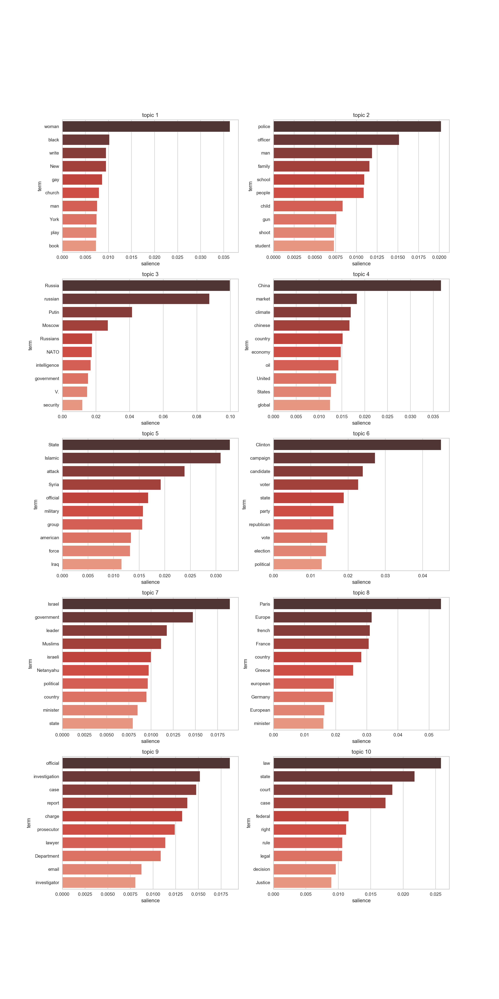

In [70]:
fiz=plt.figure(figsize=(15,30))
for i in range(10):
    df=pd.DataFrame(lda_model.show_topic(i), columns=['term','prob']).set_index('term')
#     df=df.sort_values('prob')
    
    plt.subplot(5,2,i+1)
    plt.title('topic '+str(i+1))
    sns.barplot(x='prob', y=df.index, data=df, palette='Reds_d')
    plt.xlabel('salience')
    

plt.show()

In [153]:
# def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
#     """
#     Compute c_v coherence for number of topics
# 
#     Parameters:
#     ----------
#     dictionary : Gensim dictionary
#     corpus : Gensim corpus
#     texts : List of input texts
#     limit : Max num of topics
# 
#     Returns:
#     -------
#     model_list : List of LDA topic models
#     coherence_values : Coherence values corresponding to the LDA model with respective number of topics
#     """
#     coherence_values = []
#     model_list = []
#     for num_topics in tqdm_notebook(range(start, limit, step)):
#         model = gensim.models.ldamodel.LdaModel(corpus=corpus, num_topics=num_topics, id2word=id2word)
#         model_list.append(model)
#         coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
#         coherence_values.append(coherencemodel.get_coherence())
# 
#     return model_list, coherence_values

model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=doc_list, start=2, limit=60, step=6)

# Show graph
limit=60; start=2; step=6;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Number of Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence values"), loc='best')
plt.show()

SyntaxError: EOL while scanning string literal (<ipython-input-153-35cbabeb4bbd>, line 38)

In [158]:
pprint(f"MODEL LIST: {model_list}")
pprint(f"COHERENCE VALUES: {coherence_values}")

('MODEL LIST: [<gensim.models.ldamodel.LdaModel object at 0x7f93f08b1358>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f94ffb85f98>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f942750be48>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f93e2d78eb8>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f940a3b1fd0>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f93c236f710>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f93c234d438>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f961345e048>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f9396349ef0>, '
 '<gensim.models.ldamodel.LdaModel object at 0x7f9612e59908>]')
('COHERENCE VALUES: [0.3372671451974184, 0.41778096683231813, '
 '0.4286886794661852, 0.4687603508907966, 0.49150490957879617, '
 '0.47351567765007385, 0.48116896118449937, 0.4821357435017317, '
 '0.4815461808540756, 0.46972964212682433]')


In [278]:
# bigram and trigram models
# take as argument a list of a list of words

bigram = gensim.models.Phrases(doc_list, min_count=5, threshold=500)
trigram = gensim.models.Phrases(bigram[doc_list], threshold=500)

bigram_model = gensim.models.phrases.Phraser(bigram)
trigram_model = gensim.models.phrases.Phraser(trigram)

In [ ]:
limit=40; start=2; step=6;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

# Sklearn model

In [24]:
# word_list = list(chain(*doc_list))
doc_list

[['night',
  'heavy',
  'drinking',
  'upscale',
  'London',
  'bar',
  '2016',
  'George',
  'Papadopoulos',
  'young',
  'foreign',
  'policy',
  'adviser',
  'Trump',
  'campaign',
  'startling',
  'revelation',
  'Australia',
  'diplomat',
  'Britain',
  'Russia',
  'political',
  'dirt',
  'Hillary',
  'Clinton',
  'week',
  'earlier',
  'Papadopoulos',
  'tell',
  'Moscow',
  'thousand',
  'email',
  'embarrass',
  'Clinton',
  'apparently',
  'steal',
  'effort',
  'try',
  'damage',
  'campaign',
  'exactly',
  'Papadopoulos',
  'night',
  'Kensington',
  'Wine',
  'Rooms',
  'australian',
  'Alexander',
  'Downer',
  'unclear',
  'month',
  'later',
  'leak',
  'democratic',
  'email',
  'begin',
  'appear',
  'online',
  'australian',
  'official',
  'pass',
  'information',
  'Papadopoulos',
  'american',
  'counterpart',
  'accord',
  'current',
  'american',
  'foreign',
  'official',
  'direct',
  'knowledge',
  'Australians',
  'role',
  'hacking',
  'revelation',
  'mem

In [15]:
nytimes.head()

,title,author,content,date,year,month,front_page,url,date_counter,topic0,topic1,spacy_docs
0,"How the Russia Inquiry Began: A Campaign Aide,...",Sharon LaFraniere,WASHINGTON — During a night of heavy drinking ...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/us/politics...,0_2018,us,politics,"(night, heavy, drinking, upscale, London, bar,..."
1,"For Trump, a Year of Reinventing the Presidenc...",Peter Baker,WASHINGTON — When President Trump meets with a...,2017-12-31,2017.0,12.0,True,https://www.nytimes.com/2017/12/31/us/politics...,0_2018,us,politics,"(President, Trump, meet, aide, discuss, policy..."
2,The U.S. Has Pummeled Al Qaeda in Yemen. But t...,Eric Schmitt,"MANAMA, Bahrain — The United States has triple...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/world/middl...,0_2018,world,middleeast,"(MANAMA, Bahrain, United, States, triple, numb..."
3,Why an Upstate Prisoner With a History of Esca...,William K. Rashbaum,The plan sounds ingenious. Remove two small se...,2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/da...,0_2018,nyregion,NaN,"(plan, sound, ingenious, remove, small, securi..."
4,"In Fire-Scarred Bronx Neighborhood, a World of...",Rick Rojas,"Even on a nose-numbingly cold morning, familie...",2017-12-30,2017.0,12.0,True,https://www.nytimes.com/2017/12/30/nyregion/br...,0_2018,nyregion,NaN,"(nose, numbingly, cold, morning, family, sidew..."


In [16]:
def to_text(doc, strings=False):
    if not strings:
        return [token.text for token in doc if not token.is_stop]
    else:
        return u" ".join([token.text for token in doc if not token.is_stop])

# sklearn version
# docs need to be a list of lists of STRINGS
list_of_str = nytimes['spacy_docs'].apply(lambda x: to_text(x, strings=True))
 
# settings that you use for count vectorizer will go here
#tfidf_vectorizer=TfidfVectorizer(use_idf=True)
 
# just send in all your docs here
#tfidf_vectorizer_vectors=tfidf_vectorizer.fit_transform(list_of_str)

In [30]:
# get the first vector out (for the first document)
first_vector_tfidfvectorizer=tfidf_vectorizer_vectors[3]
 
# place tf-idf values in a pandas data frame
df = pd.DataFrame(first_vector_tfidfvectorizer.T.todense(), index=tfidf_vectorizer.get_feature_names(), columns=["tfidf"])
df.sort_values(by=["tfidf"],ascending=False)

,tfidf
sweat,0.574230
malanik,0.315035
prison,0.280019
attica,0.273872
escape,0.264029
inmate,0.164216
correctional,0.100074
agency,0.088271
facility,0.080966
privilege,0.079998


In [35]:
def split_random(matrix, percent_train=70, percent_test=15):
    """
    Splits matrix data into randomly ordered sets 
    grouped by provided percentages.

    Usage:
    rows = 100
    columns = 2
    matrix = np.random.rand(rows, columns)
    training, testing, validation = \
    split_random(matrix, percent_train=80, percent_test=10)

    percent_validation 10
    training (80, 2)
    testing (10, 2)
    validation (10, 2)

    Returns:
    - training_data: percentage_train e.g. 70%
    - testing_data: percent_test e.g. 15%
    - validation_data: reminder from 100% e.g. 15%
    Created by Uki D. Lucas on Feb. 4, 2017
    """

    percent_validation = 100 - percent_train - percent_test

    if percent_validation < 0:
        print("Make sure that the provided sum of " + \
        "training and testing percentages is equal, " + \
        "or less than 100%.")
        percent_validation = 0
    else:
        print("percent_validation", percent_validation)

    #print(matrix)  
    rows = matrix.shape[0]
    np.random.shuffle(matrix)

    end_training = int(rows*percent_train/100)    
    end_testing = end_training + int((rows * percent_test/100))

    training = matrix[:end_training]
    testing = matrix[end_training:end_testing]
    validation = matrix[end_testing:]
    return training, testing, validation

# TEST:
rows = 100
columns = 2
matrix = np.random.rand(rows, columns)
training, testing, validation = split_random(matrix, percent_train=80, percent_test=10) 

print("training",training.shape)
print("testing",testing.shape)
print("validation",validation.shape)

print(split_random.__doc__)

percent_validation 10
training (80, 2)
testing (10, 2)
validation (10, 2)

    Splits matrix data into randomly ordered sets 
    grouped by provided percentages.

    Usage:
    rows = 100
    columns = 2
    matrix = np.random.rand(rows, columns)
    training, testing, validation =     split_random(matrix, percent_train=80, percent_test=10)

    percent_validation 10
    training (80, 2)
    testing (10, 2)
    validation (10, 2)

    Returns:
    - training_data: percentage_train e.g. 70%
    - testing_data: percent_test e.g. 15%
    - validation_data: reminder from 100% e.g. 15%
    Created by Uki D. Lucas on Feb. 4, 2017
    


In [52]:
n_samples = tfidf_vectorizer_vectors.shape[1]

In [58]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.datasets import make_multilabel_classification

# rng = np.random.RandomState(42)  # reproducible results with a fixed seed
# indices = np.arange(n_samples)
# rng.shuffle
# x_shuffled = [indices]
# y_shuffled = y[indices]
# 
# train = x_shuffled
# test = y_shuffled

# This produces a feature matrix of token counts, similar to what
# CountVectorizer would produce on text.
lda = LatentDirichletAllocation(n_components=5, random_state=0)
lda_model = lda.fit(tfidf_vectorizer_vectors) 

# get topics for some given samples:
print(lda.transform(tfidf_vectorizer_vectors[-2:]))

lda_output = lda.transform(tfidf_vectorizer_vectors)

print(lda_output)  # Model attributes

[[0.93398681 0.01648992 0.01650118 0.01648987 0.01653223]
 [0.96524257 0.00868951 0.00868897 0.00868946 0.00868949]
 [0.80136184 0.01382453 0.15716481 0.01382436 0.01382445]
 ...
 [0.69594567 0.01740253 0.25184684 0.01740247 0.0174025 ]
 [0.74235472 0.02191152 0.1919108  0.02191147 0.02191149]
 [0.82379144 0.01540928 0.12998123 0.01540896 0.0154091 ]]


In [59]:
# pyLDAvis.enable_notebook()
# panel = pyLDAvis.sklearn.prepare(lda, tfidf_vectorizer_vectors, tfidf_vectorizer, mds='tsne')
# panel

KeyboardInterrupt: 

In [61]:
# Diagnostics

# Log Likelihood: Higher the better
print(f"Log Likelihood: {lda_model.score(tfidf_vectorizer_vectors)}")

# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print(f"Perplexity: {lda_model.perplexity(tfidf_vectorizer_vectors)}")

# See model parameters
print(f"Model params: {lda_model.get_params()}")

Log Likelihood: -1345031.3602908638
Perplexity: 23299.567682683784
Model params: {'batch_size': 128, 'doc_topic_prior': None, 'evaluate_every': -1, 'learning_decay': 0.7, 'learning_method': 'batch', 'learning_offset': 10.0, 'max_doc_update_iter': 100, 'max_iter': 10, 'mean_change_tol': 0.001, 'n_components': 5, 'n_jobs': None, 'perp_tol': 0.1, 'random_state': 0, 'topic_word_prior': None, 'total_samples': 1000000.0, 'verbose': 0}


# TF/IDF Modeling

In [22]:
import textacy
from textacy import tm
from textacy.vsm import Vectorizer
matrix = Vectorizer(tf_type='linear', apply_idf=True, idf_type='smooth')
doc_term_matrix = matrix.fit_transform(list_of_str)

In [23]:
model = textacy.tm.TopicModel('nmf', n_topics=20)
model.fit(doc_term_matrix)

In [26]:
doc_topic_matrix = model.transform(doc_term_matrix)
doc_topic_matrix

array([[4.54179   , 2.30626021, 3.10165073, ..., 0.28859803, 0.81528488,
        0.        ],
       [5.46525078, 1.82344081, 0.44446813, ..., 0.4886186 , 0.53431278,
        0.28410335],
       [2.69583705, 1.03360436, 1.69012025, ..., 0.28551604, 0.12110943,
        0.08816146],
       ...,
       [1.23849315, 0.16818704, 0.89299763, ..., 0.02691668, 0.04138513,
        0.10015442],
       [0.54474822, 0.23406473, 0.40261177, ..., 0.01314066, 0.14053309,
        0.        ],
       [2.43676141, 0.78614537, 0.55332684, ..., 0.24347277, 0.25835928,
        0.10678282]])

In [89]:
# compare

## Non-negative Matrix Factorization

In [66]:
tfidf = TfidfVectorizer()
tfidf_output = tfidf.fit_transform(list_of_str)

In [ ]:
# vectorizer = TfidfVectorizer(
#  stop_words=custom_list,
#  min_df=20,
#  max_df=1000,
#  lowercase=False,
#  ngram_range=2)

In [27]:
from sklearn.decomposition import NMF, LatentDirichletAllocation

tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2)
tfidf = tfidf_vectorizer.fit_transform(list_of_str)
tfidf_feature_names = tfidf_vectorizer.get_feature_names()

# LDA can only use raw term counts for LDA because it is a probabilistic graphical model
tf_vectorizer = CountVectorizer(max_df=0.95, min_df=2)
tf = tf_vectorizer.fit_transform(list_of_str)
tf_feature_names = tf_vectorizer.get_feature_names()

no_topics = 20

# Run NMF
nmf = NMF(n_components=77, random_state=1, alpha=.1, l1_ratio=.5, init='nndsvd').fit(tfidf)

# Run LDA
lda = LatentDirichletAllocation(max_iter=5, learning_method='online', learning_offset=50.,random_state=0).fit(tf)

no_top_words = 10

NameError: name 'CountVectorizer' is not defined

In [ ]:
display_topics(nmf, tfidf_feature_names, no_top_words)
display_topics(lda, tf_feature_names, no_top_words)

In [ ]:
display_topics(nmf, tfidf_feature_names, no_top_words)
display_topics(lda, tf_feature_names, no_top_words)

# Testing, training, and prediction

## TTS

In [253]:
# data = nytimes['spacy_docs'].apply(lambda x: to_text(x, strings=True))
# train = data.sample(frac=0.8, random_state=77)
# test = data.drop(train.index)

## Create pipelines

In [237]:
# data = nytimes['spacy_docs'].apply(lambda x: to_text(x, strings=True))

In [28]:
from gensim.test.utils import common_corpus, common_dictionary
from gensim.sklearn_api import LdaTransformer
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import SGDClassifier
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD
import xgboost
from xgboost import XGBClassifier

In [254]:
train

4278     SAN JUAN P.R. Carmen Yulín Cruz long shoot can...
5462     LOS ANGELES roughly 87 percent white 58 percen...
2950     GENEVA President Trump prepare overseas trip w...
4200     UNITED NATIONS hardly surprise Donald J. Trump...
6498     DAHIYAT AL BARID West Bank 4:15 a.m. dead end ...
2183     Senator Mark R. Warner thinking like russian V...
7934     JERUSALEM Secretary State John Kerry issue sca...
7642     Twitter Tuesday morning President elect Donald...
10730    PARIS week Paris terrorist attack law enforcem...
2602     MEXICO CITY Mexico president dash airport gree...
3025     day spectacular collapse Fyre Festival federal...
2717     propel skyrocket return large technology stock...
5926     SAN FRANCISCO Justice Department Monday find w...
8681     Indiana republican mayor Indianapolis argue la...
8469     fractious debate possible nuclear deal Iran es...
3974     HOUSTON high wind heavy rain begin lash city o...
844      Rudolph W. Giuliani New York City mayor longti.

In [29]:
from sklearn.pipeline import make_pipeline
# vectorizers = [('count', CountVectorizer()), 
#                ('tfidf', TfidfVectorizer())]
# classifiers = [('svd', TruncatedSVD(n_components=300)), 
#                ('lda', LatentDirichletAllocation()),
#                ('xgb', XGBClassifier(max_depth=3, n_estimators=300, learning_rate=0.1))]
# parameters = {
#     'tfidf__binary': (True, False),
#     'tfidf__norm': ('l1', 'l2'),
#     'tfidf__ngram_range':(1,3),
#     'lda__n_components': [10, 25, 30, 35, 40],
#     'lda__learning_decay': [.5, .7, .9],
# }
# 
# pipe = make_pipeline([('count', CountVectorizer()),
#                      ('svd', TruncatedSVD(n_components=300)), 
#                #('lda', LatentDirichletAllocation()),
#                #('xgb', XGBClassifier(max_depth=3, n_estimators=300, learning_rate=0.1))
#                      ])
# 
# grid_search = GridSearchCV(pipe, parameters, n_jobs=-1, verbose=1)

In [ ]:
#vect = Pipeline([('cnt', CountVectorizer())])
#pipe = Pipeline([
#            ('tf', TfidfVectorizer()),
#            ('svd', TruncatedSVD(n_components=300))])

#tfidf.fit(train)

#lda = Pipeline([('svd', TruncatedSVD(n_components=300),
#                 ('scaler', StandardScaler()),
#                 ('lda', LatentDirichletAllocation()),
#                 ('xgb', XGBClassifier(max_depth=3, n_estimators=300, learning_rate=0.1))
#
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
# 
# class SkippableTruncatedSVD(TruncatedSVD):
# 
#     # add the "skip" argument and keep the others as in the superclass
#     def __init__(self,skip=False,n_components=2, algorithm="randomized", n_iter=5,
#                  random_state=None, tol=0.):
#         self.skip = skip
#         super().__init__(n_components, algorithm, n_iter, random_state, tol)
# 
#     # execute if not being skipped
#     def fit(self, X, y=None):
#         if self.skip:
#             return self
#         else:
#             return super().fit(X,y)
# 
#     # execute if not being skipped
#     def fit_transform(self, X, y=None):
#         if self.skip:
#             return X
#         else:
#             return super().fit_transform(X,y)
# 



# from sklearn.pipeline import make_pipeline 
# from sklearn.pipeline import make_union
# 
# pipe = Pipeline([('svd', TruncatedSVD(n_components=300)),
#                      ('lda', LatentDirichletAllocation())])
# 
# union = FeatureUnion([('idf', TfidfVectorizer()), 
#                                 ('pipe', pipe),
#                               ])
#('xgb', XGBClassifier(max_depth=3, n_estimators=300, learning_rate=0.1))
union = Pipeline([
        ('vec', Pipeline([ 
            ('tfidf', TfidfVectorizer(use_idf=True)),
                ])),
        ('class', FeatureUnion([
            ('c1', Pipeline([
                ('svd', TruncatedSVD(n_components=300)),
                    ])),
            ('c2', Pipeline([
                ('lda', LatentDirichletAllocation()),
            ])),
        ])),
    ('xgb', XGBClassifier(max_depth=3, n_estimators=300, learning_rate=0.1)),
])
parameters = {
     'vec__tfidf__norm': ('l1', 'l2'),
     'vec__tfidf__ngram_range': [(2,3)],
     'class__c2__lda__n_components': [25, 30, 35],
     'class__c2__lda__learning_decay': [.5, .7, .9]
 }
gridsearch = GridSearchCV(union, param_grid=parameters, cv=5,
                               n_jobs=-1, verbose=1)
gridsearch.fit(list_of_str)
#'class__c2__lda__topic_word_prior':np.arange(0.001,0.004,0.001)
#'class__c2__lda__doc_topic_prior':np.arange(0.1,0.5,0.1)
#'vec__tfidf__binary': (True, False)

Fitting 5 folds for each of 18 candidates, totalling 90 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.


# Adding bigrams and trigrams

In [258]:
doc_list

[['night',
  'heavy',
  'drinking',
  'upscale',
  'London',
  'bar',
  '2016',
  'George',
  'Papadopoulos',
  'young',
  'foreign',
  'policy',
  'adviser',
  'Trump',
  'campaign',
  'startling',
  'revelation',
  'Australia',
  'diplomat',
  'Britain',
  'Russia',
  'political',
  'dirt',
  'Hillary',
  'Clinton',
  'week',
  'earlier',
  'Papadopoulos',
  'tell',
  'Moscow',
  'thousand',
  'email',
  'embarrass',
  'Clinton',
  'apparently',
  'steal',
  'effort',
  'try',
  'damage',
  'campaign',
  'exactly',
  'Papadopoulos',
  'night',
  'Kensington',
  'Wine',
  'Rooms',
  'australian',
  'Alexander',
  'Downer',
  'unclear',
  'month',
  'later',
  'leak',
  'democratic',
  'email',
  'begin',
  'appear',
  'online',
  'australian',
  'official',
  'pass',
  'information',
  'Papadopoulos',
  'american',
  'counterpart',
  'accord',
  'current',
  'american',
  'foreign',
  'official',
  'direct',
  'knowledge',
  'Australians',
  'role',
  'hacking',
  'revelation',
  'mem

In [261]:
# See trigram example
trigram_model

In [ ]:
spacy_docs = []

for doc in tqdm_notebook(nlp.pipe(docs)):
    doc = [token.text for token in doc]
    doc = u' '.join(doc)
    spacy_docs.append(nlp.make_doc(doc))
    

In [ ]:
with open('preprocess.pickle', 'rb') as f:
    nlp = pickle.load(f)
    
nlp.add_pipe(lemmatizer,name='lemmatizer',after='ner')
nlp.pipe_names

# pickle this nlp pipeline
with open('all_pipes.pickle', 'wb') as f:
    pickle.dump(nlp, f)

# Define the property extensions

https://support.prodi.gy/t/how-to-incorporate-document-metadata/296/3

In [ ]:
from spacy.tokens import Token
from spacy.tokenizer import Tokenizer

# load the nlp preprocessor
with open('all_pipes.pickle', 'rb') as f:
    nlp = pickle.load(f)

In [ ]:
nyt = pd.concat([nyt, sdf], axis=1)

In [ ]:
nyt.head()

In [ ]:
# get position of the doc from the content
def get_topic(doc):
    index = list(np.where(nyt['spacy_docs']==doc)[0])
    topic = nyt.iloc[index]['topic0']
    return topic

Doc.set_extension("has_topic", getter=get_topic, force=True)

# Clustering

1. Bag of words: TF/IDF 
2. Given articles with these features:....

In [ ]:
# save the LDA pipeline
with open('LDA_nlp.pickle', 'w') as f:
    pickle.dump(f)

In [ ]:
   # load the model
with open('LDA_model.pickle', 'rb') as f:
    lda = pickle.loads(f.read())

In [ ]:
# mutual information scores

In [ ]:
#pmi_finder = BigramCollocationFinder.from_words(alltext)

In [ ]:
#pmi_finder.apply_freq_filter(6)
#pmi_scored = pmi_finder.score_ngrams(bigram_measures.pmi)
#pmi_scored